In [1]:
import equinox as eqx
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import optimistix as optx
from jaxtyping import Array
from optimistix import dai_yuan
from diff_xnh.optimisation.linear_CG import linear_cg

from diff_xnh import Probe, Sample
from diff_xnh.beamlines import Beamline, ProjectionConfig
from diff_xnh.magnification import fourier_magnification
from diff_xnh.optimisation import minimise
from diff_xnh.retrieval import multi_paganin
from diff_xnh.sample import empty_sample
from diff_xnh.shift import apply_shift, register_shift

%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format='retina'

In [2]:
# Setting up the model
z_total = 1.28e6
z_obj = jnp.array([4.584e3, 4.765e3, 5.488e3, 6.9895e3]) - 3.7e2
energy = 33.35  # kEV
sensor_shape = (
    1024,
    1024,
)  # NOTE: Change these to what you want, I set it like this for sample size.
pixel_pitch = 6.0
thickness = 2.0

model = Beamline(
    z_obj=z_obj,
    z_total=z_total,
    energy=energy,
    sensor_shape=sensor_shape,
    pixel_pitch=pixel_pitch,
)


# Loading probe
full_sample_size = model.FoV
probe_size = (
    sensor_shape[0] + 2 * model.pad
)  # NOTE: Not sure why this is not full sample size...

print(f"Full sample size: {model.FoV}")
print(f"Probe size: {probe_size}")

Full sample size: 1816
Probe size: 1152


In [3]:
# Generating sample
# Siemens for now, until Jakob gets here
delta = jnp.load("experiments/00_matching_baseline/siemensstar/delta.npy")
# NOTE: We clip so beta > 0
beta = jnp.maximum(jnp.load("experiments/00_matching_baseline/siemensstar/beta.npy"), 0.0)  
sample = Sample(delta, beta, thickness=2.0)

print(f"Sample size: {delta.shape}")

Sample size: (1816, 1816)


In [4]:
# Generating probe
probe_field = jnp.load("experiments/00_matching_baseline/siemensstar/probe.npy").squeeze()
probe = Probe(field=probe_field)

In [5]:
# Generating measurements
shifts_sample = jnp.load("experiments/00_matching_baseline/siemensstar/shifts_sample.npy").squeeze()
shifts_probe = jnp.load("experiments/00_matching_baseline/siemensstar/shifts_probe_proj.npy").squeeze()
config = ProjectionConfig(model.z_obj, probe_shift=shifts_probe, sample_shift=shifts_sample)
measurements = jnp.abs(eqx.filter_jit(model)(config, sample, probe))**2

# Flat field
shifts_ref = jnp.load("experiments/00_matching_baseline/siemensstar/shifts_probe_ref.npy").squeeze()
config_ref = ProjectionConfig(model.z_obj, probe_shift=shifts_ref, sample_shift=None)
reference = jnp.abs(eqx.filter_jit(model)(config_ref, empty_sample(full_sample_size), probe))**2

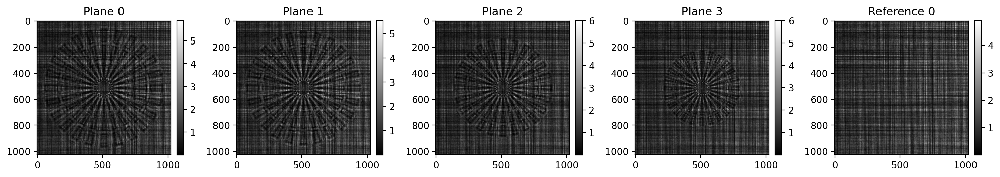

In [6]:
plt.figure(figsize=(15, 5), layout="tight")

plt.subplot(151)
plt.imshow(measurements[0], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 0")

plt.subplot(152)
plt.imshow(measurements[1], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 1")

plt.subplot(153)
plt.imshow(measurements[2], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 2")

plt.subplot(154)
plt.imshow(measurements[3], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 3")

plt.subplot(155)
plt.imshow(reference[0], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Reference 0")

plt.show()

In [7]:
# Finding the reference beam shifts
inferred_shift_ref = jax.jit(jax.vmap(lambda imgs: register_shift(imgs, reference[0], 1000)))(reference)

print(f"Inferred shift of reference beams: \n{inferred_shift_ref}")
print(f"True shift of reference beams: \n{shifts_ref}")

Inferred shift of reference beams: 
[[-0.008 -0.007]
 [ 0.72   1.81 ]
 [-1.973  0.041]
 [ 1.246  0.439]]
True shift of reference beams: 
[[ 0.          0.        ]
 [ 0.74143934  1.8135734 ]
 [-1.9842069   0.048769  ]
 [ 1.2504838   0.45010424]]


In [8]:
# Finding the reference beam shifts
inferred_shift_probe = jax.jit(jax.vmap(lambda imgs: register_shift(imgs, reference[0], 1000)))(measurements)

print(f"Inferred shift of probe during projection: \n{inferred_shift_probe}")
print(f"True shift of probe during projection: \n{shifts_probe}")

Inferred shift of probe during projection: 
[[ 1.073 -1.906]
 [ 0.499  0.999]
 [-0.012 -1.095]
 [-1.198  1.024]]
True shift of probe during projection: 
[[ 1.0852826  -1.9169922 ]
 [ 0.53459287  0.9952154 ]
 [-0.00597191 -1.1008134 ]
 [-1.2077485   1.0421228 ]]


In [9]:
# We shift back the reference probes back to the reference position
# Note we can just shift over a negative distance
reference_aligned = jax.jit(jax.vmap(apply_shift))(reference, -inferred_shift_ref).real

# And then we shift them forward to the probe position during projections
inferred_probe_shifted = jax.jit(jax.vmap(apply_shift))(reference, inferred_shift_probe).real

In [10]:
# Part 1: Rescale to same size
m = z_total / z_obj
m_rel = m / m[0]
# Note: we divide by the inferred shifted probe 
rescaled_normed_measurements = jax.vmap(fourier_magnification)(measurements / inferred_probe_shifted, mag=1 / m_rel).real

In [11]:
# Part 2: Align based on images (not reconstructions)
inferred_shift_sample = jax.jit(jax.vmap(lambda imgs: register_shift(imgs, rescaled_normed_measurements[0], 1000)))(rescaled_normed_measurements)

norm_magnifications = (model.z_total / model.z_obj) / model.m_ref
inferred_shift_sample = inferred_shift_sample * norm_magnifications[:, None]

print(f"Inferred shift of sample during projection: \n{inferred_shift_sample}")
print(f"True shift of sample during projection: \n{shifts_sample}")

rescaled_normed_aligned_measurements = jax.jit(jax.vmap(apply_shift))(rescaled_normed_measurements, -inferred_shift_sample).real


Inferred shift of sample during projection: 
[[-0.007      -0.01      ]
 [ 0.6328192   0.24641594]
 [-0.6175265   1.4178407 ]
 [ 1.1134205  -3.023869  ]]
True shift of sample during projection: 
[[ 0.   0. ]
 [ 0.6  0.3]
 [-1.3  1.5]
 [ 2.3 -3.5]]


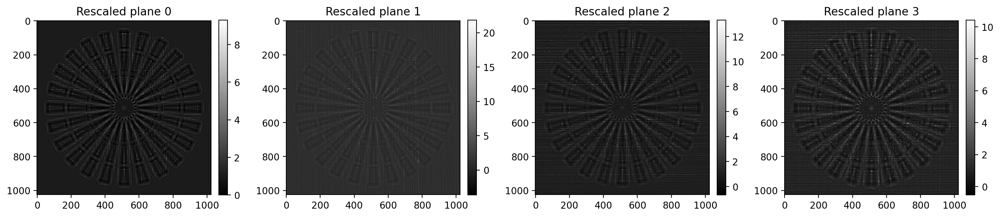

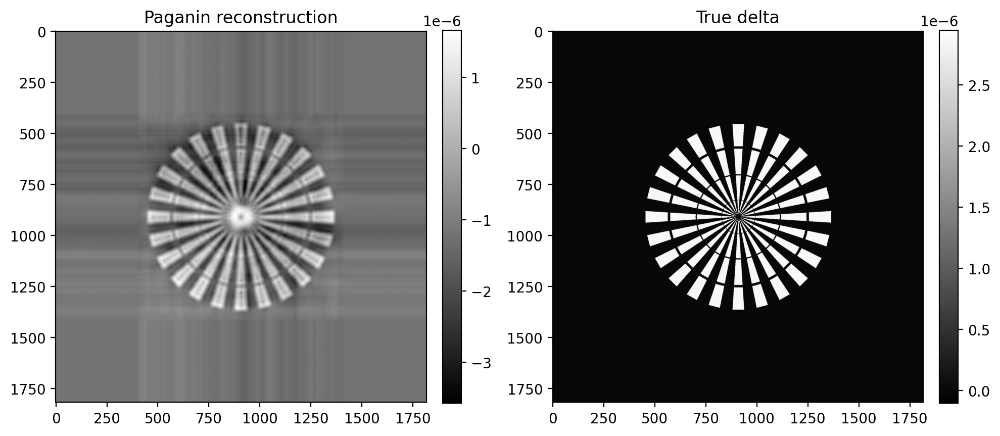

In [12]:
plt.figure(figsize=(15, 5), layout="tight")

plt.subplot(141)
plt.imshow(rescaled_normed_aligned_measurements[0], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 0")


plt.subplot(142)
plt.imshow(rescaled_normed_aligned_measurements[1], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 1")

plt.subplot(143)
plt.imshow(rescaled_normed_aligned_measurements[2], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 2")

plt.subplot(144)
plt.imshow(rescaled_normed_aligned_measurements[3], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 3")

plt.show()


# Part: Multi paganin
z_img = z_total - z_obj
z_paganin = (z_obj * z_img) / z_total

dphi_paganin = multi_paganin(
    rescaled_normed_aligned_measurements,
    z_paganin,
    model.wavelength,
    model.effective_resolution,
    delta_beta=19.0,
)

# Padding to true sample size
n_sample_pad = (full_sample_size - sensor_shape[0]) // 2
dphi_paganin = jnp.pad(dphi_paganin, n_sample_pad, "edge")

# Turning dphi into delta & beta
k = 2 * jnp.pi / model.wavelength
delta_paganin = dphi_paganin.real / (k * thickness)
beta_paganin = dphi_paganin.imag / (k * thickness)

plt.figure(figsize=(10, 5), layout="tight")
plt.subplot(121)
plt.title("Paganin reconstruction")
plt.imshow(delta_paganin, cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)

plt.title("True delta")
plt.imshow(delta, cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)

plt.show()

In [13]:
# For the linear CG, we need two functions
# 1) A forward_fn, returning the output field (!!) - abs / intensity will break things
# 2) A norm fn, returning the loss between the forward_fn and something else
# Note that the forward_fn must be approximately linear in its parameters
def forward_fn(params, args):
    (probe_field, ) = params
    (_, config) = args
    probe = Probe(amplitude=jnp.abs(probe_field), phase=jnp.angle(probe_field))
    return model(config, empty_sample(full_sample_size), probe)

def norm_fn(approximate, args):
    (reference, _) = args
    # sum is the same as squared norm
    return 0.5 * jnp.sum((jnp.abs(approximate) - jnp.sqrt(reference))**2)

In [14]:
# We initialise like this
config_ref_inferred = ProjectionConfig(model.z_obj, probe_shift=inferred_shift_ref, sample_shift=None)
inferred_probe = jnp.ones((probe_size, probe_size), jnp.complex64)

solution = linear_cg(forward_fn, norm_fn, (inferred_probe, ), (reference, config_ref_inferred))
init_probe = Probe(amplitude=jnp.abs(solution.value[0]), phase=jnp.angle(solution.value[0]))

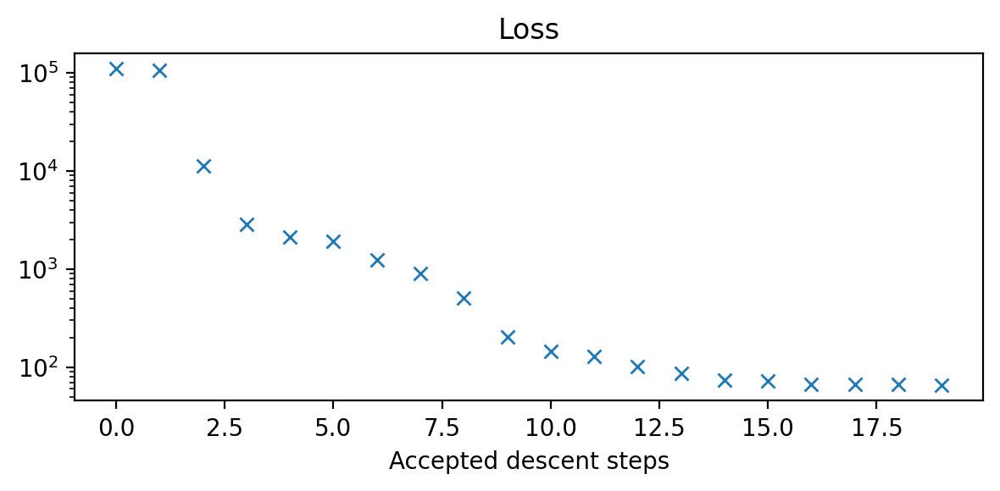

In [15]:
plt.figure(figsize=(6, 3), layout="tight")

plt.semilogy(solution.stats["loss"], 'x')
plt.title("Loss")
plt.xlabel("Accepted descent steps")

plt.show()

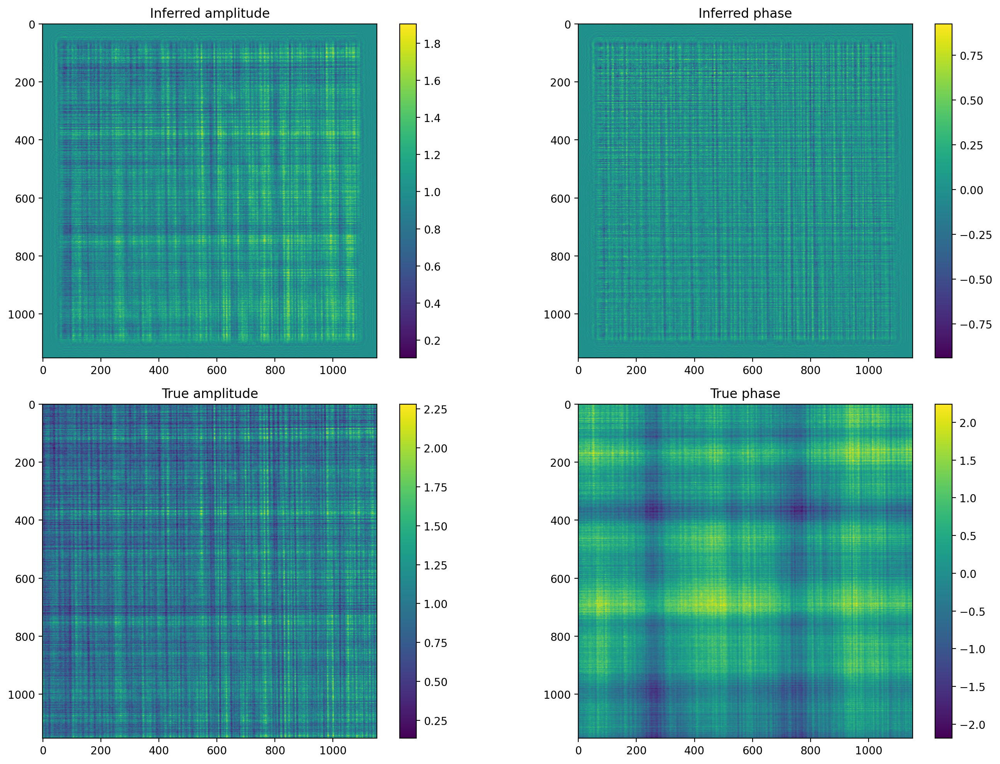

In [16]:
# NOTE: This looks pretty similar to holotomocupy
plt.figure(figsize=(15, 10), layout="tight")

plt.subplot(221)
plt.imshow(init_probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred amplitude")

plt.subplot(222)
plt.imshow(init_probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred phase")

plt.subplot(223)
plt.imshow(probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True amplitude")

plt.subplot(224)
plt.imshow(probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True phase")

plt.show()

Text(0.5, 1.0, 'Cross section of phase')

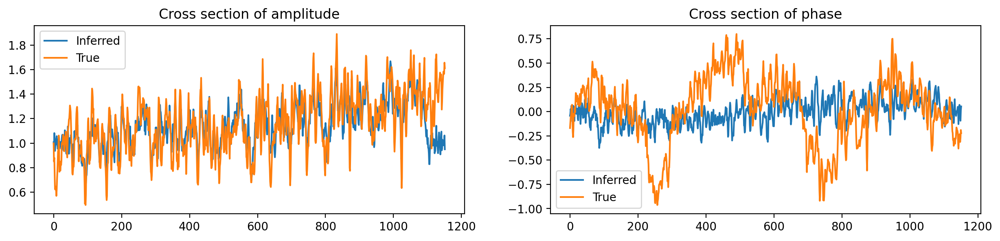

In [17]:
plt.figure(figsize=(15, 3))

plt.subplot(121)
plt.plot(init_probe.amplitude.squeeze()[576], label="Inferred")
plt.plot(probe.amplitude.squeeze()[576], label="True")
plt.legend()
plt.title("Cross section of amplitude")


plt.subplot(122)
plt.plot(init_probe.phase.squeeze()[576], label="Inferred")
plt.plot(probe.phase.squeeze()[576], label="True")
plt.legend()
plt.title("Cross section of phase")

In [ ]:
# Learning sample function
def forward_fn_sample(params, args):
    (sample_field, ) = params
    (_, probe, config) = args

    # We do this here because we optimise the field change due to the sample; not the sample itself.
    # This makes the loss function approximately linear in the sample, and we can use the much faster
    # linear CG method.  
    delta = -jnp.log(sample_field + 1e-8).imag / (thickness * 2 * jnp.pi) * model.wavelength
    beta = -jnp.log(sample_field + 1e-8).real / (thickness * 2 * jnp.pi) * model.wavelength
    sample = Sample(delta = delta, beta=beta, thickness=thickness)
    return model(config, sample, probe)

def norm_fn(approximate, args):
    (measurements, _) = args
    # sum is the same as squared norm
    return 0.5 * jnp.sum((jnp.abs(approximate) - jnp.sqrt(measurements))**2)


def loss_fn_sample(params: tuple[Array, Array], args: tuple[Probe, Array]) -> Array:
    probe, measurements = args
    sample = Sample(delta=params[0], beta=params[1], thickness=thickness)
    projection = model(config_inferred, sample, probe)
    return jnp.linalg.norm(jnp.sqrt(projection) - jnp.sqrt(measurements)) ** 2

def loss_fn_probe(params: tuple[Probe], args: tuple[Sample, Array, Array]) -> Array:
    (sample, reference, measurements) = args
    (probe, ) = params

    # Empty beam first
    reference_approx = model(config_ref_inferred, empty_sample(full_sample_size), probe)

    # With sample
    projection = model(config_inferred, sample, probe)

    return jnp.linalg.norm(jnp.sqrt(reference_approx) - jnp.sqrt(reference)) ** 2 + jnp.linalg.norm(jnp.sqrt(projection) - jnp.sqrt(measurements)) ** 2




In [19]:
delta_paganin.shape

(1816, 1816)

In [ ]:
# We initialise like this
config_inferred = ProjectionConfig(model.z_obj, probe_shift=inferred_shift_probe, sample_shift=inferred_shift_sample)
inferred_probe = init_probe
sample_field = 


solution = linear_cg(forward_fn_sample, norm_fn, (inferred_probe, ), (measurements, inferred_probe, config_inferred))

In [18]:
n_steps = 64
n_steps_sample = 1
n_steps_probe = 1

solver = NonlinearCG(
    rtol=1e-3,
    atol=1e-3,
    method=dai_yuan,
    search = optx.BacktrackingArmijo(slope=1e-8, step_init=0.5)
)

# Init
inferred_sample = Sample(delta_paganin, beta_paganin, thickness=thickness)
inferred_probe = init_probe

solver_sample_state = None
solver_probe_state = None

stats_sample = []
stats_probe = []

for idx in range(n_steps):
    # Take a few steps in the sample direction
    solution = eqx.filter_jit(minimise)(loss_fn_sample, solver, (inferred_sample.delta, inferred_sample.beta), (inferred_probe, measurements), max_steps=n_steps_sample, state=solver_sample_state, max_backtrack=10)
    inferred_sample = Sample(solution.value[0], jnp.clip(solution.value[1], 0.0), thickness=thickness) # clip; can't have emission
    solver_sample_state = solution.state
    stats_sample.append(solution.stats)

    # Take a few steps in the probe direction
    solution = eqx.filter_jit(minimise)(loss_fn_probe, solver, (inferred_probe, ), (inferred_sample, reference, measurements), max_steps=n_steps_probe, state=solver_probe_state, max_backtrack=10)
    inferred_probe = solution.value[0]
    solver_probe_state = solution.state
    stats_probe.append(solution.stats)

    print(f"Finished step {idx}")

Finished step 0
Finished step 1
Finished step 2
Finished step 3
Finished step 4
Finished step 5
Finished step 6
Finished step 7
Finished step 8
Finished step 9
Finished step 10
Finished step 11
Finished step 12
Finished step 13
Finished step 14
Finished step 15
Finished step 16
Finished step 17
Finished step 18
Finished step 19
Finished step 20
Finished step 21
Finished step 22
Finished step 23
Finished step 24
Finished step 25
Finished step 26
Finished step 27
Finished step 28
Finished step 29
Finished step 30
Finished step 31
Finished step 32
Finished step 33
Finished step 34
Finished step 35
Finished step 36
Finished step 37
Finished step 38
Finished step 39
Finished step 40
Finished step 41
Finished step 42
Finished step 43
Finished step 44
Finished step 45
Finished step 46
Finished step 47
Finished step 48
Finished step 49
Finished step 50
Finished step 51
Finished step 52
Finished step 53
Finished step 54
Finished step 55
Finished step 56
Finished step 57
Finished step 58
Finishe

Text(0.5, 1.0, 'Probe loss')

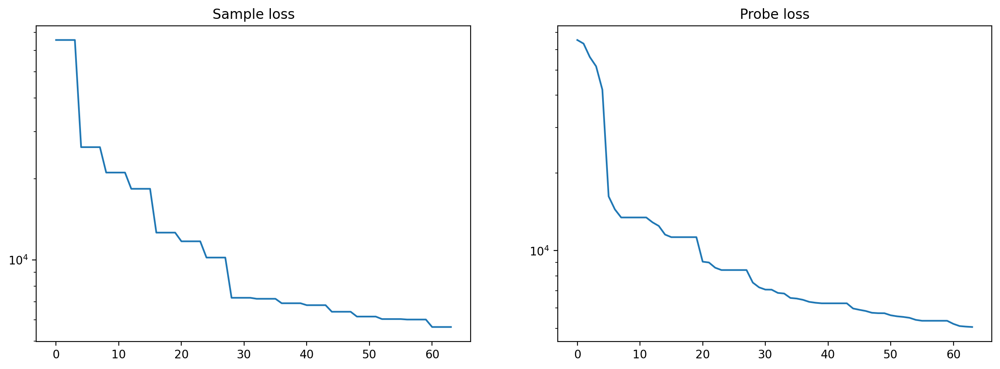

In [30]:
loss_sample = jnp.concat([stats["loss"][:stats["steps"]] for stats in stats_sample])
loss_probe = jnp.concat([stats["loss"][:stats["steps"]] for stats in stats_probe])

plt.figure(figsize=(15, 5))
plt.subplot(121)
plt.semilogy(loss_sample)
plt.title("Sample loss")

plt.subplot(122)
plt.semilogy(loss_probe)
plt.title("Probe loss")

Text(0.5, 1.0, 'True beta')

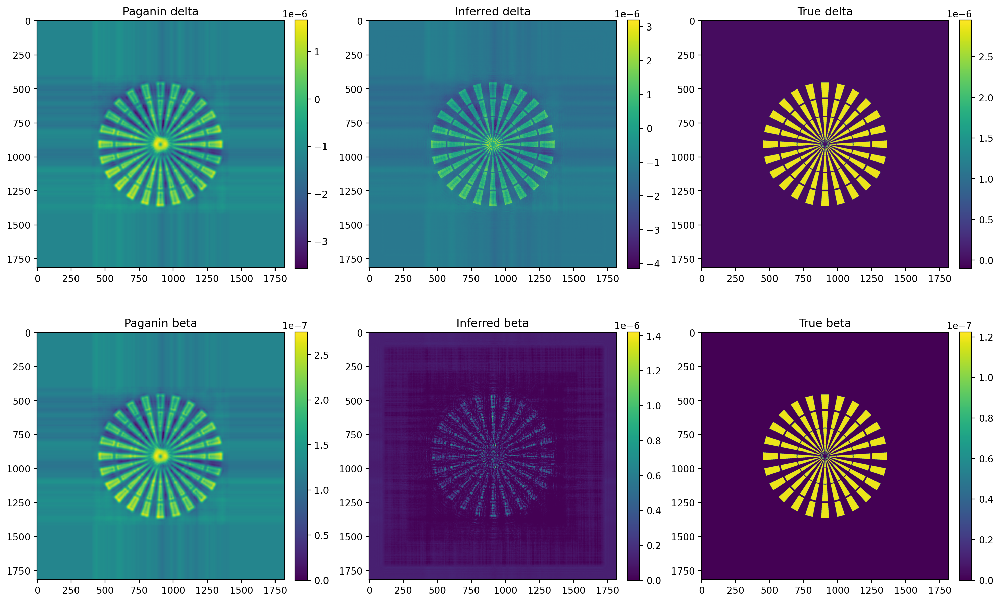

In [25]:
# NOTE: This looks pretty similar to holotomocupy
plt.figure(figsize=(15, 10), layout="tight")

plt.subplot(231)
plt.imshow(delta_paganin.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Paganin delta")

plt.subplot(232)
plt.imshow(inferred_sample.delta.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred delta")

plt.subplot(233)
plt.imshow(delta)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True delta")

plt.subplot(234)
plt.imshow(beta_paganin.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Paganin beta")

plt.subplot(235)
plt.imshow(inferred_sample.beta.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred beta")

plt.subplot(236)
plt.imshow(beta)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True beta")

Text(0.5, 1.0, 'True phase')

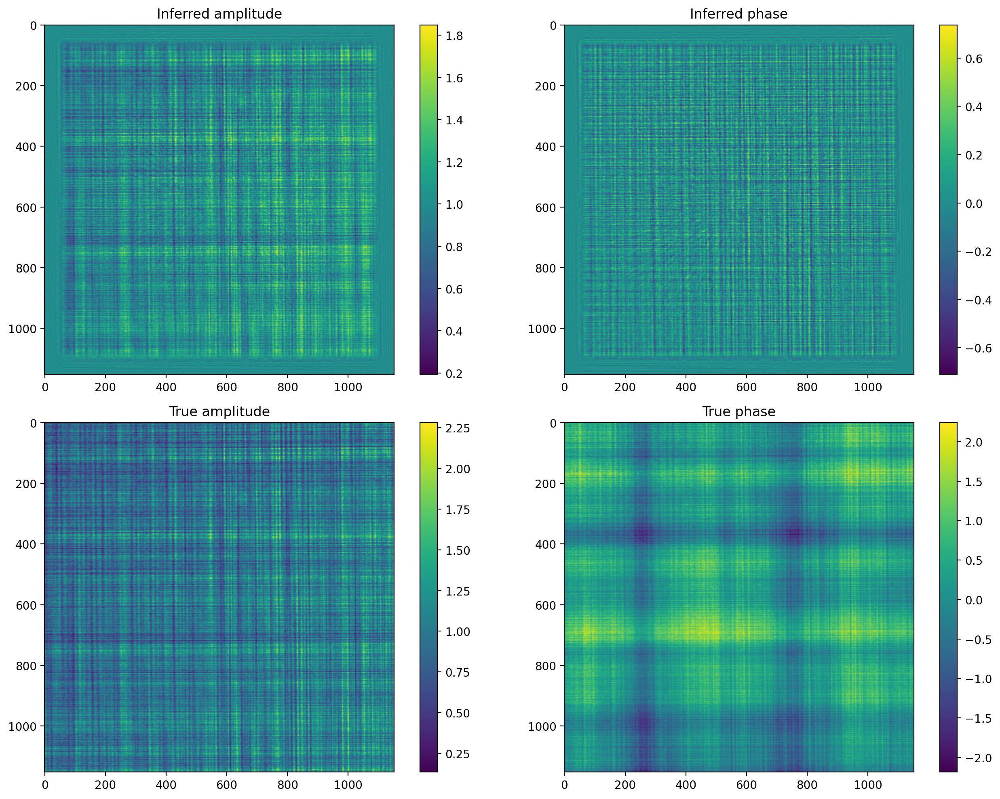

In [26]:
# NOTE: This looks pretty similar to holotomocupy
plt.figure(figsize=(15, 10), layout="tight")

plt.subplot(221)
plt.imshow(inferred_probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred amplitude")

plt.subplot(222)
plt.imshow(inferred_probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred phase")

plt.subplot(223)
plt.imshow(probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True amplitude")

plt.subplot(224)
plt.imshow(probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True phase")

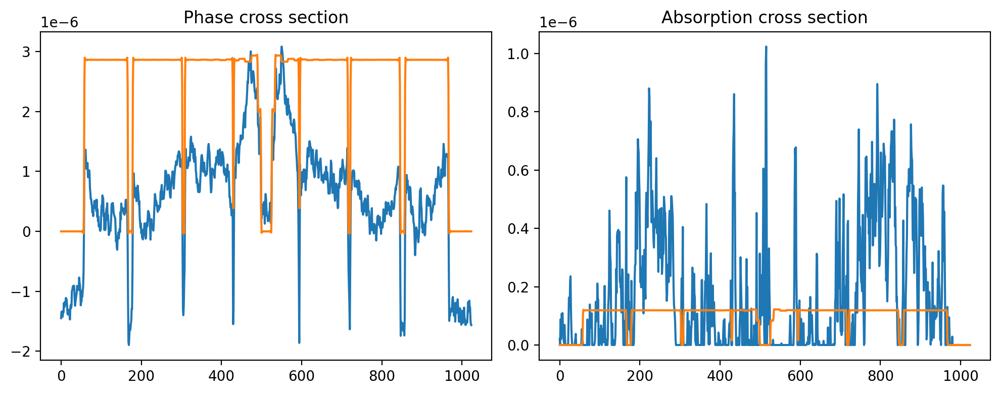

In [27]:
plt.figure(figsize=(10, 4), layout="tight")
plt.subplot(121)
plt.title("Phase cross section")
plt.plot(inferred_sample.delta.squeeze()[396:-396, 396:-396][512])
plt.plot(delta.squeeze()[396:-396, 396:-396][512])


plt.subplot(122)
plt.title("Absorption cross section")
plt.plot(inferred_sample.beta.squeeze()[396:-396, 396:-396][512])
plt.plot(beta.squeeze()[396:-396, 396:-396][512])


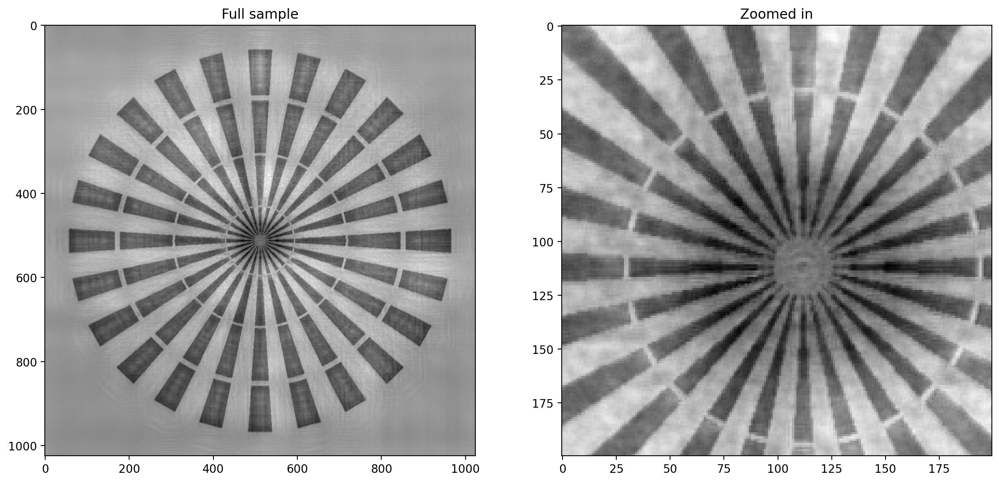

In [28]:
plt.figure(figsize=(15, 7))

plt.subplot(121)
plt.title("Full sample")
plt.imshow(inferred_sample.delta.squeeze()[396:-396, 396: -396], cmap="gray_r")

plt.subplot(122)
plt.title("Zoomed in")
plt.imshow(inferred_sample.delta.squeeze()[396:-396, 396: -396][400:600, 400:600], cmap="gray_r")

plt.show()